<a href="https://colab.research.google.com/github/joylin0209/40133HW/blob/main/JoyLin_hw9.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Week 9 - Images, Art & Video
This week, we "transcend" text to explore analysis of sound and visual content. Trillions of digital audio, image, and video files have been generated by cell phones and distributed sensors, preserved and shared through social medial, the web, private and government administrations. In this notebook, we read in and visualize audio and image files, process them to extract relevant features and measurement, then begin to explore how to analyze and extract information from them through the same approaches to supervised and unsupervised learning we have performed thoughout the quarter with text.

This notebook does not requires GPU to run.

For this notebook we will use the following packages:

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
#Special module written for this class
#This provides access to data and to helper functions from previous weeks
#Make sure you update it before starting this notebook
!pip install git+https://github.com/UChicago-Computational-Content-Analysis/lucem_illud.git
import lucem_illud

#All these packages need to be installed from pip
import scipy #For frequency analysis
import scipy.fftpack
import nltk #the Natural Language Toolkit
import requests #For downloading our datasets
import numpy as np #for arrays
import pandas #gives us DataFrames
import matplotlib.pyplot as plt #For graphics
import seaborn #Makes the graphics look nicer
import IPython #To show stuff

#Image handling install as Pillow
import PIL
import PIL.ImageOps

#install as scikit-image, this does the image manupulation
import skimage
import skimage.feature
import skimage.segmentation
import skimage.filters
import skimage.color
import skimage.graph
import skimage.future.graph

#these three do audio handling
import pydub #Requires ffmpeg to be installed https://www.ffmpeg.org/download.html; on a mac "brew install ffmpeg"
import speech_recognition #install as speechrecognition
import soundfile #Install as pysoundfile

#This 'magic' command makes the plots work better
#in the notebook, don't use it outside of a notebook.
#Also you can ignore the warning it may generate.
%matplotlib inline

import os
import os.path
import csv
import re

  Cloning https://github.com/UChicago-Computational-Content-Analysis/lucem_illud.git to /tmp/pip-req-build-uaoedmy6
  Running command git clone --filter=blob:none --quiet https://github.com/UChicago-Computational-Content-Analysis/lucem_illud.git /tmp/pip-req-build-uaoedmy6
  Resolved https://github.com/UChicago-Computational-Content-Analysis/lucem_illud.git to commit b17a265d3b8253424e5b38872457f7437909a65d
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.6/239.6 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.8/117.8 kB 10.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 195.4/195.4 kB 12.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.8/76.8 kB 8.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 12.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 32.8/32.8 MB 26.5 MB/s eta 0:00:00
     ━━━━━━━━━━

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
cd /content/drive/MyDrive/Colab\ Notebooks/Computational\ Content\ Analysis/Homework-Notebooks-2024-Winter/week\ 9

/content/drive/MyDrive/Colab Notebooks/Computational Content Analysis/Homework-Notebooks-2024-Winter/week 9


# Audio analysis

First we will consider media that predates written language...sound and spoken language. Audio (and video) files come in two major categories, lossy or lossless. Lossless files save all information the microphone recorded. Lossy files, by contrast, drop sections humans are unlikely to notice. Recorded frequencies for both types are then typically compressed, which introduces further loss. To work with audio files, we want a format that is preferably lossless or minimally compressed. We will work with `wav` files here. Note that `mp3` is not acceptable. If you do not have `wav` files, we can use python to convert to `wav`.

You might need to install ```ffmpeg``` and ```ffprobe```.

In [ ]:
samplePath = '/content/drive/MyDrive/SOCI40133/data/audio_samples/SBC060.mp3'
transcriptPath = '/content/drive/MyDrive/SOCI40133/data/audio_samples/SBC060.trn'

IPython.display.Audio(samplePath)

In [ ]:
# We are using a different package to convert than the in the rest of the code
def convertToWAV(sourceFile, outputFile, overwrite = False):
    if os.path.isfile(outputFile) and not overwrite:
        print("{} exists already".format(outputFile))
        return
    #Naive format extraction
    sourceFormat = sourceFile.split('.')[-1]
    sound = pydub.AudioSegment.from_file(sourceFile, format=sourceFormat)
    sound.export(outputFile, format="wav")
    print("{} created".format(outputFile))
wavPath = 'sample.wav'
convertToWAV(samplePath, wavPath)

Now that we have created our `wav` file, notice that it is much larger than the source `mp3`. We can load it with `soundfile` and work with it as a numpy data array.

In [ ]:
soundArr, soundSampleRate = soundfile.read(wavPath)
soundArr.shape

(65705472, 2)

This is the raw data as a column array, which contains two channels (Left and Right) of the recording device. Some files, of course, will have more columns (from more microphones). The array comprises a series of numbers that measure the location of the speaker membrane (0=resting location). By quickly and rhythmically changing the location a note can be achieved. The larger the variation from the center, the louder the sound; the faster the oscillations, the higher the pitch. (The center of the oscillations does not have to be 0).

In [ ]:
soundSampleRate

The other piece of information we get is the sample rate. This tells us how many measurements made per second, which allows us to know how long the entire recording is:

In [ ]:
numS = soundArr.shape[0] // soundSampleRate
print("The sample is {} seconds long".format(numS))
print("Or {:.2f} minutes".format(numS / 60))

The final critical parameter of sound digitization is quantisation, which consists in assigning a value to each sample according to its amplitude. These values are attributed according to a bit scale. A quantisation of 8 bit will assign amplitude values along a scale of $2^8 = 256$ states around 0. Most recording systems use a $2^{16} = 65536$ bit system. Quantisation is a rounding process, where high bit quantisation produces values close to reality with values rounded to a high number of significant digits, and low bit quantisation produces values further from reality with values rounded a low number of significants digits. Low quantisation can lead to impaired quality signal. <img src="../data/bitrate.png"> This figure illustrates how digital sounds is a discrete process along the amplitude scale: a 3 bit, $2^3=8$, quantization (gray bars) gives a rough approximation of the sin wave (red line).

Let's look at the first second of the recording:

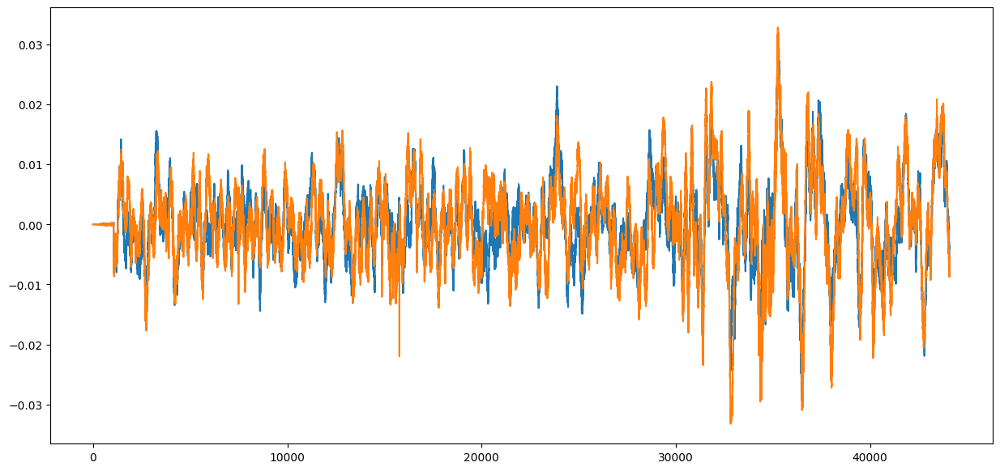

In [ ]:
fig, ax = plt.subplots(figsize = (15, 7))
ax.plot(soundArr[:soundSampleRate])
plt.show()

We get 2 (Left and Right) nearly "flat" (or equally wavy) lines. This means that there is very little noise at this part of the recording. What variation exists is due to compression or interference and represents the slight hiss you sometimes hear in low quality recordings.

Let's expand our scope and look at the first 10 seconds:

In [ ]:
soundArr.shape

(65705472, 2)

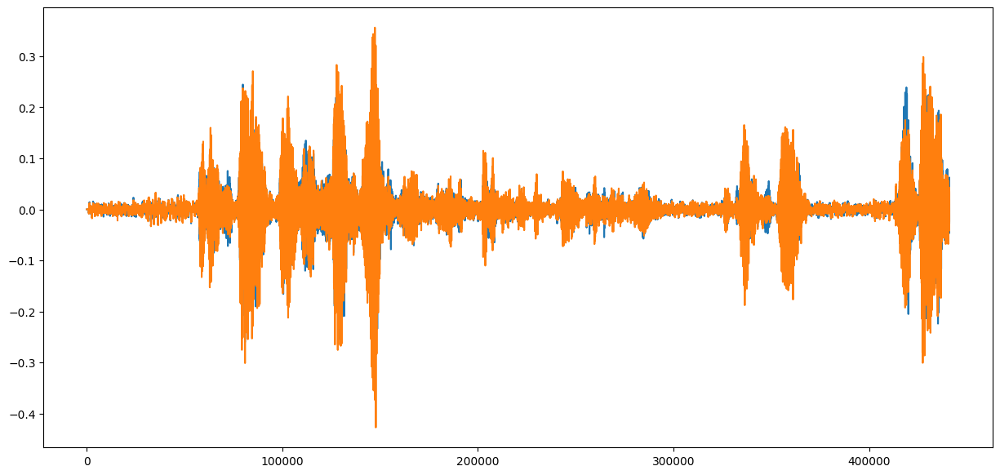

In [ ]:
fig, ax = plt.subplots(figsize = (15, 7))
ax.plot(soundArr[:soundSampleRate * 10])
plt.show()

Now we can see definite spikes, where each represents a word or discrete sound.

To see what the different parts correspond to, we can use a transcript. Because we got this file from the [Santa Barbara Corpus of Spoken American English
](http://www.linguistics.ucsb.edu/research/santa-barbara-corpus#Contents), we just need to load the metadata, which includes a transcription.

In [ ]:
def loadTranscript(targetFile):
    #Regex because the transcripts aren't consistent enough to use csv
    regex = re.compile(r"(\d+\.\d+)\s(\d+\.\d+)\s(.+:)?\s+(.*)")
    dfDict = {
        'time_start' : [],
        'time_end' : [],
        'speaker' : [],
        'text' : [],
    }
    with open(targetFile, encoding='latin-1') as f:
        for line in f:
            r = re.match(regex, line)
            dfDict['time_start'].append(float(r.group(1)))
            dfDict['time_end'].append(float(r.group(2)))
            if r.group(3) is None:
                dfDict['speaker'].append(dfDict['speaker'][-1])
            else:
                dfDict['speaker'].append(r.group(3))
            dfDict['text'].append(r.group(4))
    return pandas.DataFrame(dfDict)

transcriptDF = loadTranscript(transcriptPath)
transcriptDF[:10]

,time_start,time_end,speaker,text
0,0.000,2.572,ALAN:,"... (H) I got a story to tell you,"
1,2.572,3.820,ALAN:,"it's a shaggy dog story,"
2,3.820,6.645,ALAN:,but as long as were talking about that record...
3,6.645,8.378,ALAN:,"(H)= Ill tell you the story,"
4,8.378,10.178,ALAN:,"(H)= oh gosh,"
5,10.178,10.678,ALAN:,"uh (Hx),"
6,10.678,12.335,ALAN:,"Rae and I and Sue and Buddy,"
7,12.335,14.727,ALAN:,"... took a trip,"
8,14.727,17.012,ALAN:,"... to Mexico City,"
9,17.012,18.761,JON:,... (SNIFF)


Now let's look at a few sub-sections. First, to make things easier, we will convert the seconds markers to sample indices:

In [ ]:
#Need to be ints for indexing, luckily being off by a couple indices doesn't matter
transcriptDF['index_start'] = (transcriptDF['time_start'] * soundSampleRate).astype('int')
transcriptDF['index_end'] = (transcriptDF['time_end'] * soundSampleRate).astype('int')

Lets see what `'Rae and I and Sue and Buddy,'` looks like, which is the seventh row:

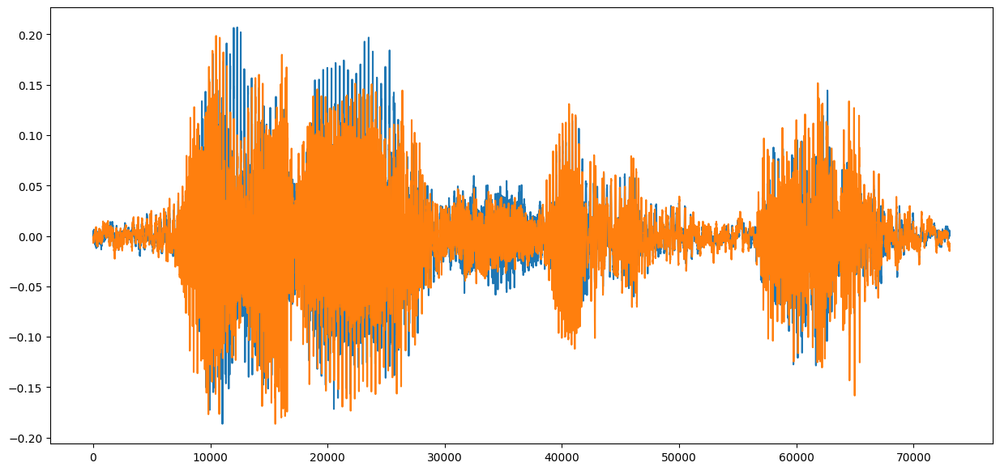

In [ ]:
fig, ax = plt.subplots(figsize = (15, 7))
subSample1 = soundArr[transcriptDF['index_start'][6]: transcriptDF['index_end'][6]]
ax.plot(subSample1)
plt.show()

And now let's hear what that sounds like:

In [ ]:
soundfile.write('/content/drive/MyDrive/SOCI40133/data/audio_samples/sample1.wav', subSample1, soundSampleRate)
IPython.display.Audio('/content/drive/MyDrive/SOCI40133/data/audio_samples/sample1.wav')

In order to see sounds in the frequency space, we can take the Fourier transform. This is a reversible mathematical transform named after the French mathematician Joseph Fourier (1768-1830) <img src="data/Fourier.jpg">. The transform decomposes a time series into a sum of finite series of sine or cosine functions.

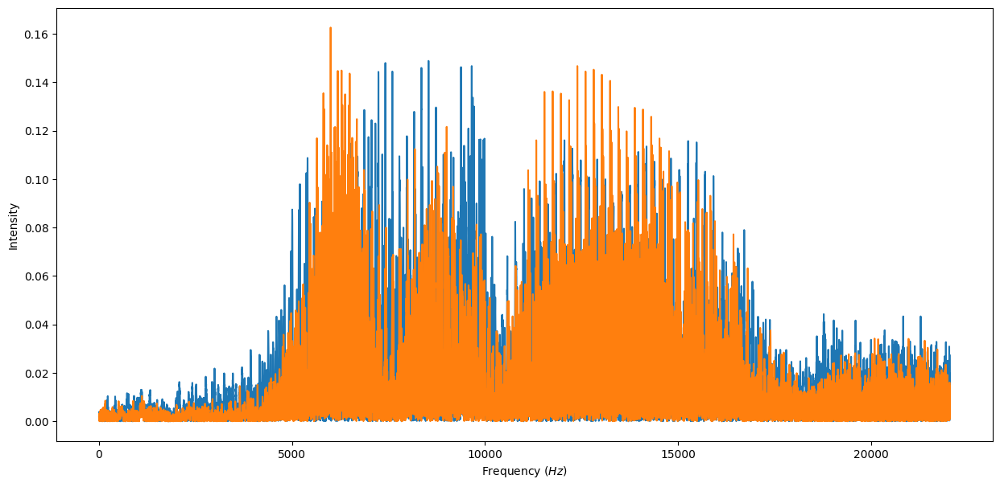

In [ ]:
sample1FFT = scipy.fftpack.ifft(subSample1)
N = len(sample1FFT)
freq = scipy.fftpack.fftfreq(N, d = 1 / soundSampleRate)
fig, ax = plt.subplots(figsize = (15, 7))
ax.set_xlabel('Frequency ($Hz$)')
ax.set_ylabel('Intensity')
ax.plot(freq[:N//2], abs(sample1FFT)[:N//2]) #Only want positive frequencies
plt.show()

This shows that there are two frequencies to the 'Rae and I and Sue and Buddy' snippet: a higher pitched 'Rae and I...Sue...Buddy' (~14000 *Hz*) and the final two 'and's (one at ~6000 *Hz* and the second at ~8000 *Hz*).

What does a sniff look like?

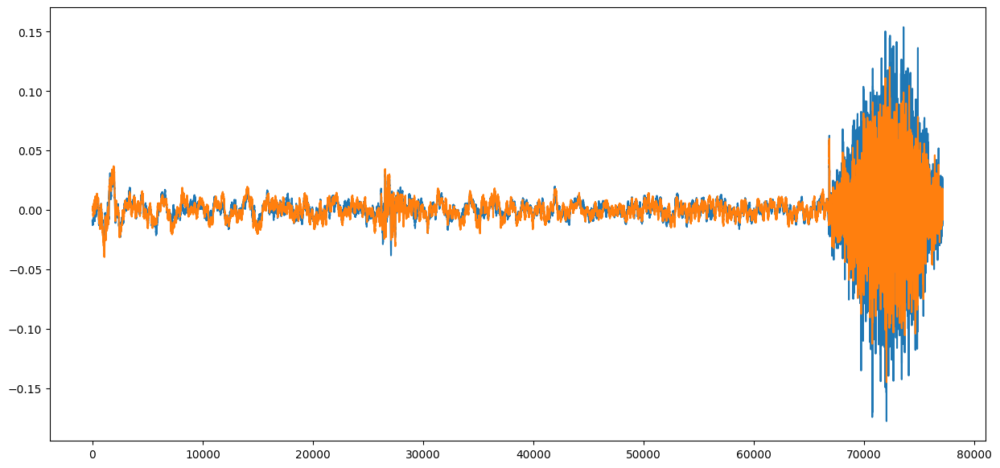

In [ ]:
fig, ax = plt.subplots(figsize = (15, 7))
subSample2 = soundArr[transcriptDF['index_start'][9]: transcriptDF['index_end'][9]]
ax.plot(subSample2)
plt.show()

Very different from speech. And now let's see what that sounds like:

In [ ]:
soundfile.write('/content/drive/MyDrive/SOCI40133/data/audio_samples/sample2.wav', subSample2, soundSampleRate)
IPython.display.Audio('/content/drive/MyDrive/SOCI40133/data/audio_samples/sample2.wav')

and in frequency space:

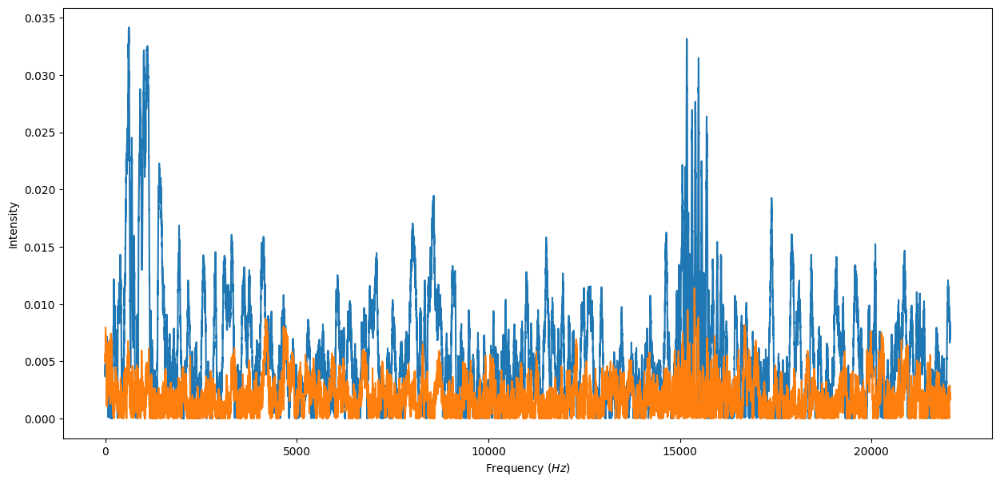

In [ ]:
sample2FFT = scipy.fftpack.ifft(subSample2)
N = len(sample2FFT)
freq = scipy.fftpack.fftfreq(N, d = 1 / soundSampleRate)
fig, ax = plt.subplots(figsize = (15, 7))
ax.plot(freq[:N//2], abs(sample2FFT)[:N//2]) #Only want positive frequencies
ax.set_xlabel('Frequency ($Hz$)')
ax.set_ylabel('Intensity')
plt.show()

Notice how there is not a dominant frequency for the sniff as there was for the noun phrase earlier. This means that the sniff activated noise all across the frequency spectrum.

We can also investigate dominant frequencies for the entire record:

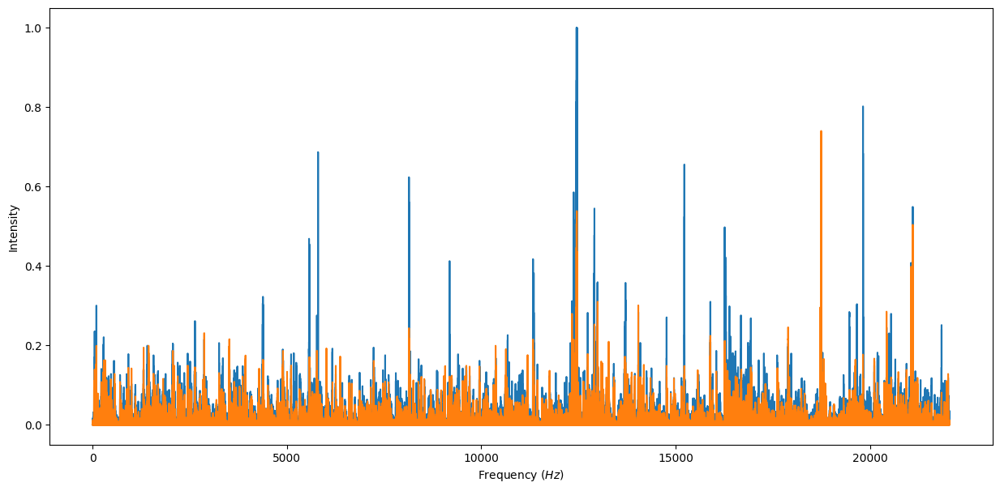

In [ ]:
#This can take a minute
fig, ax = plt.subplots(figsize = (15, 7))
fullFFT = scipy.fftpack.ifft(soundArr)
N = len(fullFFT)
freq = scipy.fftpack.fftfreq(N, d = 1 / soundSampleRate)
ax.plot(freq[:N//2], abs(fullFFT)[:N//2]) #Only want positive frequencies
ax.set_xlabel('Frequency ($Hz$)')
ax.set_ylabel('Intensity')
plt.show()

In [ ]:
freq[len(freq) // 2 -10: len(freq) // 2 + 5]

array([ 22049.99328823,  22049.99395941,  22049.99463058,  22049.99530176,
        22049.99597294,  22049.99664412,  22049.99731529,  22049.99798647,
        22049.99865765,  22049.99932882, -22050.        , -22049.99932882,
       -22049.99865765, -22049.99798647, -22049.99731529])

Here we capture each person's frequencies across their entire collection of statements:

In [ ]:
def maxfreq(sample, topN = 10):
    sampleFFT = scipy.fftpack.ifft(sample)
    N = len(sample)
    freqs = scipy.fftpack.fftfreq(N, d = 1 / soundSampleRate)
    tops =  np.argpartition(abs(sampleFFT[:, 0]), -topN)[-topN:]

    return np.mean(tops)

freqs = []
for i, row in transcriptDF.iterrows():
    freqs.append(maxfreq(soundArr[row['index_start']: row['index_end']]))

transcriptDF['frequency FFT'] = freqs

Alan's speech exhibits the following frequencies:

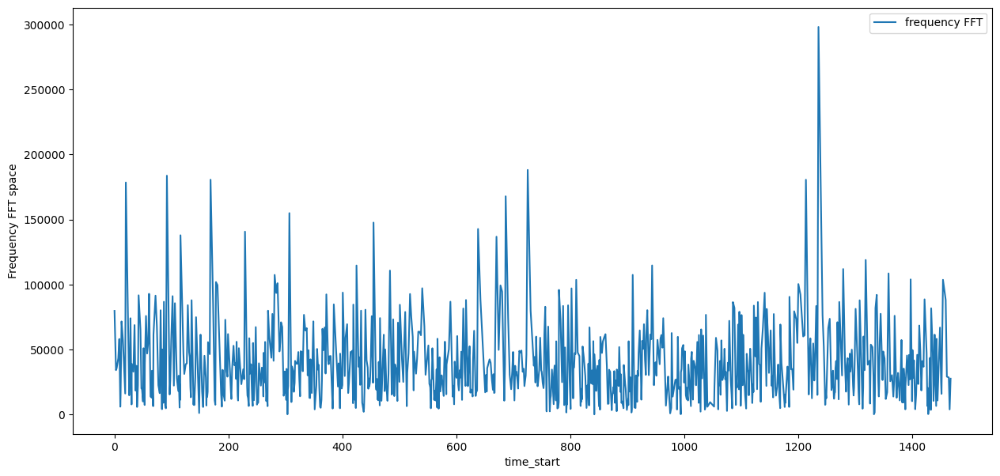

In [ ]:
fig, ax = plt.subplots(figsize = (15, 7))
transcriptDF[transcriptDF['speaker'] == 'ALAN:'].plot( 'time_start', 'frequency FFT', ax = ax)
ax.set_ylabel("Frequency FFT space")
plt.show()

...while Jon's voice is **much** lower:

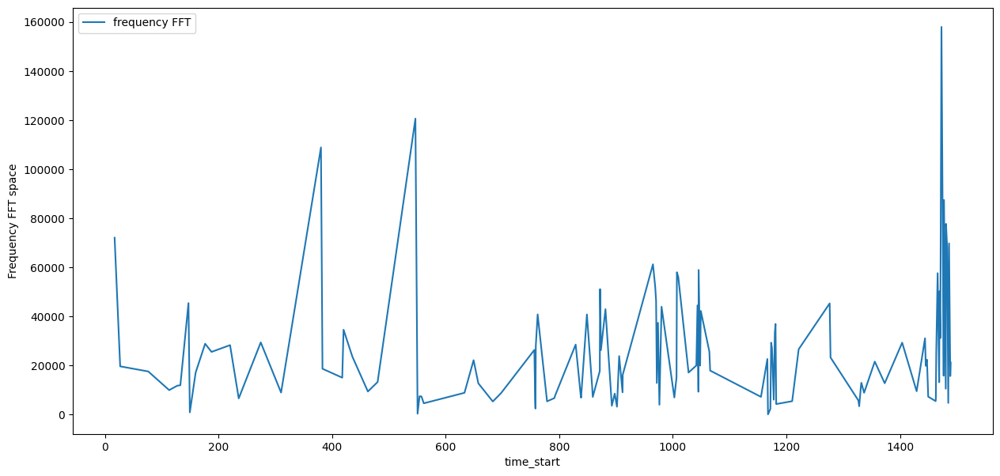

In [ ]:
fig, ax = plt.subplots(figsize = (15, 7))
transcriptDF[transcriptDF['speaker'] == 'JON:'].plot( 'time_start', 'frequency FFT', ax = ax)
ax.set_ylabel("Frequency FFT space")
plt.show()

Or we can look at them togther

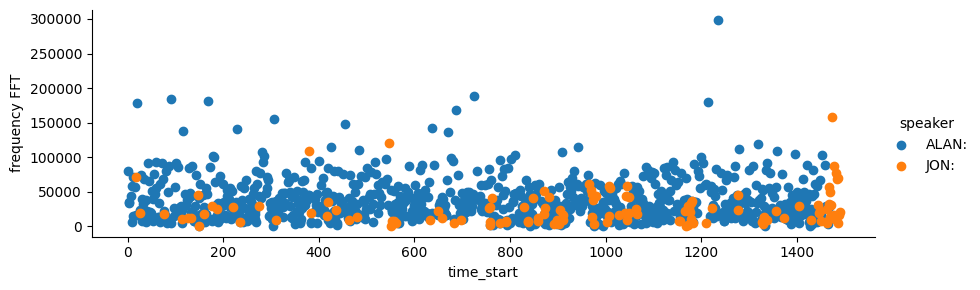

In [ ]:
fg = seaborn.FacetGrid(data=transcriptDF, hue='speaker', aspect = 3)
fg.map(plt.scatter, 'time_start', 'frequency FFT').add_legend()

## Speech-to-Text

We can also do speech recognition on audio, but this requires a complex machine learning system. Luckily there are many online services to do this. We have a function that uses Google's API. There are two API's: one is free but limited; the other is commercial and you can provide the function `speechRec` with a file containing the API keys, using `jsonFile=` if you wish. For more about this look [here](https://stackoverflow.com/questions/38703853/how-to-use-google-speech-recognition-api-in-python) or the `speech_recognition` [docs](https://github.com/Uberi/speech_recognition).

In [ ]:
#Using another library so we need to use files again
def speechRec(targetFile, language = "en-US", raw = False, jsonFile = ''):
    r = speech_recognition.Recognizer()
    if not os.path.isfile(jsonFile):
        jsonString = None
    else:
        with open(jsonFile) as f:
            jsonString = f.read()
    with speech_recognition.AudioFile(targetFile) as source:
        audio = r.record(source)
    try:
        if jsonString is None:
            print("Sending data to Google Speech Recognition")
            dat =  r.recognize_google(audio)
        else:
            print("Sending data to Google Cloud Speech")
            dat =  r.recognize_google_cloud(audio, credentials_json=jsonString)
    except speech_recognition.UnknownValueError:
        print("Google could not understand audio")
    except speech_recognition.RequestError as e:
        print("Could not request results from Google service; {0}".format(e))
    else:
        print("Success")
        return dat

The example above is of too low quality so we will be using another file `data/audio_samples/english.wav`

In [ ]:
import wave

# open up a wave
wf = wave.open('/content/drive/MyDrive/SOCI40133/data/audio_samples/english.wav', 'rb')
swidth = wf.getsampwidth()
RATE = wf.getframerate()

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/SOCI40133/data/audio_samples/english.wav', rate=RATE)

In [ ]:
speechRec('/content/drive/MyDrive/SOCI40133/data/audio_samples/english.wav')

Sending data to Google Speech Recognition
Success


"but what if somebody decides to break it be careful that you keep adequate coverage but look for places to save money maybe it's taking longer to get things squared away then the bankers expected hiring the wife for once company may win her tax aided retirement income the Boost is helpful but inadequate new self-deceiving Rags or hersley tossed on the two naked bones what a discussion Canyon Sue when the title of this type of song is in question there's no dying or waxing or gassing needed paperweight maybe personalized on Place work on a flat surface and smooth out the simplest kind of system uses a single self-contained unit the old shop added still holds a good mechanic is usually a bad boss both figures some make beautiful chairs cabinets doll houses at"

## <font color="red">*Exercise 1*</font>

<font color="red">Construct cells immediately below this that read in 10 audio files (e.g., produced on your smartphone recorder?) from at least two different speakers, which include sentences of different types (e.g., question, statement, exclamation). At least two of these should include recordings of the two speakers talking to each other (e.g., a simple question/answer). Contrast the frequency distributions of the words spoken within speaker. What speaker's voice has a higher and which has lower frequency? What words are spoken at the highest and lowest frequencies? What parts-of-speech tend to be high or low? How do different types of sentences vary in their frequency differently? When people are speaking to each other, how do their frequencies change? Whose changes more?
    
OR

<font color="red">Construct cells immediately below this that use the 10 audio files from at least two different speakers read in previously, attempt to automatically extract the words from Google, and calculate the word-error rate, as descibed in Chapter 9 from *Jurafsky & Martin*, page 334. How well does it do? Under what circumstances does it perform poorly?

In [ ]:
!pip install numpy pandas librosa nltk matplotlib pydub


In [ ]:
import os
import numpy as np
import pandas as pd
import librosa
import nltk
from nltk.tokenize import word_tokenize
import glob
import IPython.display

In [ ]:
from pydub import AudioSegment

# 定义音频文件所在的文件夹路径
folder_path = '/content/drive/MyDrive/SOCI40133/HW9'

# 获取文件夹中的所有 MP3 文件列表
audio_files = [file for file in os.listdir(folder_path) if file.endswith('.mp3')]

# 循环读取每个 MP3 文件并将其转换为 WAV 格式
for file in audio_files:
    # 构造输入 MP3 文件的完整路径
    mp3_file_path = os.path.join(folder_path, file)

    # 构造输出 WAV 文件的完整路径
    wav_file_path = os.path.join(folder_path, os.path.splitext(file)[0] + '.wav')

    # 使用 pydub 加载 MP3 文件
    audio = AudioSegment.from_mp3(mp3_file_path)

    # 将 MP3 文件转换为 WAV 格式并保存
    audio.export(wav_file_path, format='wav')


In [ ]:
def list_wav_files_in_folder(folder_path):
    wav_files = []
    for file in glob.glob(os.path.join(folder_path, '*.wav')):
        wav_files.append(file)
    return wav_files

folder_path = '/content/drive/MyDrive/SOCI40133/hw9ex1'
audio_files = list_wav_files_in_folder(folder_path)
print("WAV files found:")
for file in audio_files:
    print(file)



WAV files found:
/content/drive/MyDrive/SOCI40133/hw9ex1/meiyu1378_2742779yGd.wav
/content/drive/MyDrive/SOCI40133/hw9ex1/goldilocks-shorter.wav
/content/drive/MyDrive/SOCI40133/hw9ex1/meiyu1380_28362363GM.wav
/content/drive/MyDrive/SOCI40133/hw9ex1/hey-diddle-diddle.wav
/content/drive/MyDrive/SOCI40133/hw9ex1/mouse-cake.wav
/content/drive/MyDrive/SOCI40133/hw9ex1/Little-red-riding-hood-even-shorter.wav
/content/drive/MyDrive/SOCI40133/hw9ex1/little-miss-muffet.wav
/content/drive/MyDrive/SOCI40133/hw9ex1/mary-had-a-little-lamb-gabby.wav
/content/drive/MyDrive/SOCI40133/hw9ex1/2010-04-25-storynory-the-grateful-crane.wav
/content/drive/MyDrive/SOCI40133/hw9ex1/lazyjack.wav


I chose ten audio files, eight of which are from https://www.storynory.com/, including songs and stories. The other two are from https://m.kekenet.com/, and the content is dialogue.
The following is the content of each audio file. In view of the different lengths of each audio file, the content of audio files that are too long cannot be previewed smoothly, so only part of the content is shown.

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/SOCI40133/hw9ex1/little-miss-muffet.wav')

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/SOCI40133/hw9ex1/mary-had-a-little-lamb-gabby.wav')

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/SOCI40133/hw9ex1/2010-04-25-storynory-the-grateful-crane.wav')

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/SOCI40133/hw9ex1/hey-diddle-diddle.wav')

In [ ]:
import os
import speech_recognition

def extract_text_from_audio(audio_file, language="en-US", raw=False, json_file=''):
    r = speech_recognition.Recognizer()
    if not os.path.isfile(json_file):
        json_string = None
    else:
        with open(json_file) as f:
            json_string = f.read()
    with speech_recognition.AudioFile(audio_file) as source:
        audio = r.record(source)
    try:
        if json_string is None:
            print("Sending data to Google Speech Recognition")
            text = r.recognize_google(audio)
        else:
            print("Sending data to Google Cloud Speech")
            text = r.recognize_google_cloud(audio, credentials_json=json_string)
    except speech_recognition.UnknownValueError:
        print("Google could not understand audio")
        text = ""
    except speech_recognition.RequestError as e:
        print("Could not request results from Google service; {0}".format(e))
        text = ""
    else:
        print("Success")
    return text



In [ ]:
audio_names = ['little-miss-muffet',
 'mary-had-a-little-lamb-gabby',
 'hey-diddle-diddle',
 'meiyu1378_2742779yGd',
 'goldilocks-shorter',
 'Little-red-riding-hood-even-shorter',
 'mouse-cake',
 'meiyu1380_28362363GM',
 '2010-04-25-storynory-the-grateful-crane',
 'lazyjack']

audio_files = [f'/content/drive/MyDrive/SOCI40133/hw9ex1/{name}.wav' for name in audio_names]
audio_reference_text_path = [f'/content/drive/MyDrive/SOCI40133/hw9ex1/{name}.txt' for name in audio_names]

In [ ]:
# 現在您可以使用這個函數來提取音訊檔案中的文字
audio_text = []
for file in audio_files:
    text = extract_text_from_audio(file)
    audio_text.append(text)
print("Extracted text:", audio_text)

Sending data to Google Speech Recognition
Success
Sending data to Google Speech Recognition
Success
Sending data to Google Speech Recognition
Success
Sending data to Google Speech Recognition
Success
Sending data to Google Speech Recognition
Success
Sending data to Google Speech Recognition
Success
Sending data to Google Speech Recognition
Success
Sending data to Google Speech Recognition
Success
Sending data to Google Speech Recognition
Success
Sending data to Google Speech Recognition
Success
Extracted text: ['Little Miss Muffet sat on a tuffet eating her curds and whey Along came a spider and sat down beside her and frightened Miss Muffet away', 'Mary had a little lamb its fleece was white as snow and everywhere that Mary went the lamb was sure to go it followed her to school one day which was against the rule it made the children laugh and play to see a lamb at school and so the teacher turned it out but still it linger and waited patiently about till Mary did appear why does the l

In [ ]:
def audio_reference_text_clean(file_path):
    with open(file_path, 'r', encoding='utf-8') as file:
        text = file.read().lower()
    text = text.replace('\n', ' ')
    text = re.sub(r'[^\w\s]', '', text)
    text = re.sub(r'\s+', ' ', text)
    return text

audio_reference_text_path = ['/content/drive/MyDrive/SOCI40133/hw9ex1/little-miss-muffet.txt',
 '/content/drive/MyDrive/SOCI40133/hw9ex1/mary-had-a-little-lamb-gabby.txt',
 '/content/drive/MyDrive/SOCI40133/hw9ex1/hey-diddle-diddle.txt',
 '/content/drive/MyDrive/SOCI40133/hw9ex1/meiyu1378_2742779yGd.txt',
 '/content/drive/MyDrive/SOCI40133/hw9ex1/goldilocks-shorter.txt',
 '/content/drive/MyDrive/SOCI40133/hw9ex1/Little-red-riding-hood-even-shorter.txt',
 '/content/drive/MyDrive/SOCI40133/hw9ex1/mouse-cake.txt',
 '/content/drive/MyDrive/SOCI40133/hw9ex1/meiyu1380_28362363GM.txt',
 '/content/drive/MyDrive/SOCI40133/hw9ex1/2010-04-25-storynory-the-grateful-crane.txt',
 '/content/drive/MyDrive/SOCI40133/hw9ex1/lazyjack.txt']

audio_reference_text = []
for txt_path in audio_reference_text_path:
    txt = audio_reference_text_clean(txt_path)
    audio_reference_text.append(txt)
print(audio_reference_text )

['little miss muffet sat on a tuffet eating her curds and whey along came a spider who sat down beside her and frightened miss muffet away', 'mary had a little lamb its fleece was white as snow and everywhere that mary went the lamb was sure to go it followed her to school one day which was against the rule it made the children laugh and play to see a lamb at school and so the teacher turned it out but still it lingered near and waited patiently about till mary did appear why does the lamb love mary so the eager children cry why mary loves the lamb you know the teacher did reply', 'hey diddle diddle the cat and the fiddle the cow jumped over the moon the little dog laughed to see such sport and the dish ran away with the spoon', 'okay so how about one not related to food all work and no play makes jack a dull boy which i guess means if you just work all the time and you dont rest and relax and have fun then youll just be a boring person well actually any kind of extreme has health cons

In [ ]:
!pip install jiwer

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 24.1 MB/s eta 0:00:00


In [ ]:
import jiwer

In [ ]:
audio_names = ['little-miss-muffet',
 'mary-had-a-little-lamb-gabby',
 'hey-diddle-diddle',
 'meiyu1378_2742779yGd',
 'goldilocks-shorter',
 'Little-red-riding-hood-even-shorter',
 'mouse-cake',
 'meiyu1380_28362363GM',
 '2010-04-25-storynory-the-grateful-crane',
 'lazyjack']

transformation = jiwer.Compose([
    jiwer.ExpandCommonEnglishContractions(),
    jiwer.RemoveEmptyStrings(),
    jiwer.ToLowerCase(),
    jiwer.RemoveMultipleSpaces(),
    jiwer.Strip(),
    jiwer.RemovePunctuation(),
    jiwer.ReduceToListOfListOfWords(),
])

for i in range(len(audio_names)):
    wer = jiwer.wer(audio_reference_text[i], audio_text[i], truth_transform=transformation, hypothesis_transform=transformation)
    print(f"Word Error Rate of {audio_names[i]}: {wer*100}%")

Word Error Rate of little-miss-muffet: 3.8461538461538463%
Word Error Rate of mary-had-a-little-lamb-gabby: 4.49438202247191%
Word Error Rate of hey-diddle-diddle: 3.3333333333333335%
Word Error Rate of meiyu1378_2742779yGd: 16.94915254237288%
Word Error Rate of goldilocks-shorter: 13.131313131313133%
Word Error Rate of Little-red-riding-hood-even-shorter: 36.31123919308357%
Word Error Rate of mouse-cake: 17.2%
Word Error Rate of meiyu1380_28362363GM: 47.77070063694268%
Word Error Rate of 2010-04-25-storynory-the-grateful-crane: 8.16326530612245%
Word Error Rate of lazyjack: 4.25531914893617%


In this task, I first defined a function to extract text from an audio file. I used Google Speech Recognition API to perform this task as it provides accurate and powerful speech recognition capabilities. I loaded each audio file and converted it to an audio object, then used the Google Speech Recognition API to convert the audio to text. Next, I loaded the reference text for each audio file, which was obtained from the audio file's website. I cleaned the reference text to ensure it was consistent with the extracted text format, including converting to lowercase, removing punctuation, removing extra spaces, etc. Finally, I used the Jiwer library to calculate the word error rate (WER), a measure of the accuracy of text transcription, for each audio file. The word error rate represents the degree of difference between the extracted text and the reference text, and is calculated by comparing the edit distance between the two texts. Through these steps, I was able to gain a detailed understanding of the transcription quality of the audio files, and I could compare and analyze different audio files to evaluate the performance of the speech recognition system.

Judging from the results, the error rate between most audio files converted into text and the actual text is not high, only the error rate between the two is higher. It is speculated that the reasons affecting interpretation comparison are:
1. Errors when converting audio files into text (including poor speech recognition model quality, voice quality, dialect or accent, and vocabulary mismatch)
2. Errors in the Jiwer package for calculating differences between text transcriptions (selection of conversion function, corpus matching, version)

# Deep Learning for Audio

Today, most state of the art methods involving audio uses deep learning methods to embed audio in a high dimensional space - similar to some of the methods we have seen before for text. While earlier methods for speech feature extraction and classification used audio features such as some of what we saw earlier in this notebook (frequencies), as well as power (via the [Mel-frequency cepstrum](https://en.wikipedia.org/wiki/Mel-frequency_cepstrum) coefficients), the success of word2vec quickly inspired [speech2vec](https://arxiv.org/pdf/1803.08976.pdf) method to use these features to construct semantically coherent vectors. This was a jump from the acoustic and phenome based vectors previously calculated. Further work has lead to state-of-the-art wav2vec2, which we will explore in this section. We will be revisiting the Transformers package we saw last week, this time using them to load pre-trained wav2vec2 models for both creating a vector representation to making a transcription. In the example below we use a sample from librispeech, which is also what this model was trained on.

In [ ]:
!pip install -q datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 536.7/536.7 kB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 10.9 MB/s eta 0:00:00


In [ ]:
from transformers import Wav2Vec2Tokenizer, Wav2Vec2Model
from datasets import load_dataset
import soundfile as sf

tokenizer = Wav2Vec2Tokenizer.from_pretrained("facebook/wav2vec2-base-960h")
model = Wav2Vec2Model.from_pretrained("facebook/wav2vec2-base-960h")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/163 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/291 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/85.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.60k [00:00<?, ?B/s]

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'Wav2Vec2CTCTokenizer'. 
The class this function is called from is 'Wav2Vec2Tokenizer'.


model.safetensors:   0%|          | 0.00/378M [00:00<?, ?B/s]

Some weights of Wav2Vec2Model were not initialized from the model checkpoint at facebook/wav2vec2-base-960h and are newly initialized: ['wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original0', 'wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original1', 'wav2vec2.masked_spec_embed']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
def map_to_array(batch):
    speech, _ = sf.read(batch["file"])
    batch["speech"] = speech
    return batch

In [ ]:
ds = load_dataset("patrickvonplaten/librispeech_asr_dummy", "clean", split="validation")

Generating validation split: 0 examples [00:00, ? examples/s]

In [ ]:
ds = ds.map(map_to_array)
input_values = tokenizer(ds["speech"][0], return_tensors="pt").input_values  # Batch size 1
hidden_states = model(input_values).last_hidden_state

Map:   0%|          | 0/73 [00:00<?, ? examples/s]

In [ ]:
hidden_states

tensor([[[-0.0032, -0.0086,  0.0228,  ..., -0.1943,  0.0403, -0.1071],
         [ 0.0021, -0.0078,  0.0205,  ..., -0.2157,  0.0311, -0.1106],
         [-0.0056, -0.0330,  0.0698,  ..., -0.2463, -0.0076, -0.1500],
         ...,
         [-0.0060, -0.0336,  0.0704,  ..., -0.2466, -0.0082, -0.1501],
         [-0.0013, -0.0162,  0.0132,  ..., -0.1883,  0.0449, -0.0850],
         [-0.0029, -0.0174,  0.0129,  ..., -0.1893,  0.0441, -0.0821]]],
       grad_fn=<NativeLayerNormBackward0>)

The hidden state of the model serves as the embedding for the file. Below is the cosine similarity function - how would you use it to measure between audio embeddings?

In [ ]:
import torch.nn as nn
import torch

In [ ]:
cos = nn.CosineSimilarity(dim=1, eps=1e-6)

In [ ]:
from transformers import Wav2Vec2ForCTC

In [ ]:
model = Wav2Vec2ForCTC.from_pretrained("facebook/wav2vec2-base-960h")

Some weights of the model checkpoint at facebook/wav2vec2-base-960h were not used when initializing Wav2Vec2ForCTC: ['wav2vec2.encoder.pos_conv_embed.conv.weight_g', 'wav2vec2.encoder.pos_conv_embed.conv.weight_v']
- This IS expected if you are initializing Wav2Vec2ForCTC from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing Wav2Vec2ForCTC from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of Wav2Vec2ForCTC were not initialized from the model checkpoint at facebook/wav2vec2-base-960h and are newly initialized: ['wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original0', 'wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original1', 'wav2vec2.masked_spec_embed']
You sho

In [ ]:
logits = model(input_values).logits

In [ ]:
predicted_ids = torch.argmax(logits, dim=-1)

In [ ]:
transcription = tokenizer.decode(predicted_ids[0])

In [ ]:
transcription

'MISTER QUILTER IS THE APOSTLE OF THE MIDDLE CLASSES AND WE ARE GLAD TO WELCOME HIS GOSPEL'

We see here how we can quite easily transcribe text straight off the model from Transformers!

## <font color="red">*Exercise 2*</font>

<font color="red"> We've seen two ways in which we can use the wav2vec2 model from Transformers - to generate a high dimensional embedding, and to transcribe an audio file into text. All of this is done using a Deep Neural model!

<font color="red"> In the following cells, use these methods to conduct analysis of the 10 audio files which you have - maybe add 2 songs to the mix as well. How do the embeddings cluster the audio files? Which files are most similar to each other? How does the model perform with respect to a file recorded by you versus a song, versus the sample dataset? How can you incorporate the wav2vec2 model and other multi-modal data into your projects?



I use a series of audio files, some contain speech from different speakers; some of which are songs. I extracted speech features (embeddings) from these audio files and visualized them in 3D to see how they are distributed in the embedding space.

First, I load each audio file and extract its speech features. I used a pretrained speech recognition model to convert each audio file into an embedding vector. I then organized these embedding vectors into a numpy array and assigned each vector a corresponding label, which is a filename.

Next, I projected the embedding vectors into 3D space and assigned each filename a unique color to distinguish different files in the visualization. I then used the matplotlib library to create a three-dimensional scatter plot, where each point represents an embedding vector and the color represents its corresponding file name.

I expected to use this visualization to visually observe how the speech features between different audio files are distributed in the embedding space, thereby better understanding the similarities and differences between them.

In [ ]:
from transformers import Wav2Vec2Tokenizer, Wav2Vec2Model, Wav2Vec2ForCTC
import soundfile as sf
import torch
import torch.nn as nn
import librosa
import numpy as np
from transformers import Wav2Vec2ForCTC, Wav2Vec2Tokenizer
from sklearn.cluster import KMeans
from sklearn.metrics.pairwise import cosine_similarity

In [ ]:
tokenizer = Wav2Vec2Tokenizer.from_pretrained("facebook/wav2vec2-base-960h")
model = Wav2Vec2Model.from_pretrained("facebook/wav2vec2-base-960h")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/163 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/291 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/85.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.60k [00:00<?, ?B/s]

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'Wav2Vec2CTCTokenizer'. 
The class this function is called from is 'Wav2Vec2Tokenizer'.
/usr/local/lib/python3.10/dist-packages/transformers/models/wav2vec2/tokenization_wav2vec2.py:733: FutureWarning: The class `Wav2Vec2Tokenizer` is deprecated and will be removed in version 5 of Transformers. Please use `Wav2Vec2Processor` or `Wav2Vec2CTCTokenizer` instead.
  warnings.warn(


model.safetensors:   0%|          | 0.00/378M [00:00<?, ?B/s]

Some weights of Wav2Vec2Model were not initialized from the model checkpoint at facebook/wav2vec2-base-960h and are newly initialized: ['wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original0', 'wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original1', 'wav2vec2.masked_spec_embed']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
audio_files = [('/content/drive/MyDrive/SOCI40133/HW9/dailylife001.wav', 'dailylife001.wav'),
 ('/content/drive/MyDrive/SOCI40133/HW9/dailylife002.wav', 'dailylife002.wav'),
 ('/content/drive/MyDrive/SOCI40133/HW9/dailylife003.wav', 'dailylife003.wav'),
 ('/content/drive/MyDrive/SOCI40133/HW9/dailylife004.wav', 'dailylife004.wav'),
 ('/content/drive/MyDrive/SOCI40133/HW9/dailylife005.wav', 'dailylife005.wav'),
 ('/content/drive/MyDrive/SOCI40133/HW9/dailylife006.wav', 'dailylife006.wav'),
 ('/content/drive/MyDrive/SOCI40133/HW9/dailylife007.wav', 'dailylife007.wav'),
 ('/content/drive/MyDrive/SOCI40133/HW9/kill-this-love.wav', 'kill-this-love.wav'),
 ('/content/drive/MyDrive/SOCI40133/HW9/love-story.wav', 'love-story.wav'),
 ('/content/drive/MyDrive/SOCI40133/HW9/stay.wav', 'stay.wav')]

In [ ]:
# Function to extract embeddings from audio file
def extract_embeddings(audio_file, file_name):
    waveform, sample_rate = librosa.load(audio_file, sr=16000)
    inputs = tokenizer(waveform, return_tensors="pt", padding="longest").input_values
    with torch.no_grad():
        embeddings = model(inputs).last_hidden_state.squeeze(0).numpy()
    print(audio_file + ' completed.')

    return embeddings, [file_name] * len(embeddings)


# Extract embeddings from each audio file
embeddings_group = [extract_embeddings(audio_file, audio) for audio_file, audio in audio_files]
embeddings = [emb for emb, _ in embeddings_group]
labels = []
for _, lab in embeddings_group:
  labels.extend(lab)

# Convert embeddings to numpy array
embeddings_array = np.concatenate(embeddings, axis=0)
labels = np.array(labels)

/content/drive/MyDrive/SOCI40133/HW9/dailylife001.wav completed.
/content/drive/MyDrive/SOCI40133/HW9/dailylife002.wav completed.
/content/drive/MyDrive/SOCI40133/HW9/dailylife003.wav completed.
/content/drive/MyDrive/SOCI40133/HW9/dailylife004.wav completed.
/content/drive/MyDrive/SOCI40133/HW9/dailylife005.wav completed.
/content/drive/MyDrive/SOCI40133/HW9/dailylife006.wav completed.
/content/drive/MyDrive/SOCI40133/HW9/dailylife007.wav completed.
/content/drive/MyDrive/SOCI40133/HW9/kill-this-love.wav completed.
/content/drive/MyDrive/SOCI40133/HW9/love-story.wav completed.
/content/drive/MyDrive/SOCI40133/HW9/stay.wav completed.


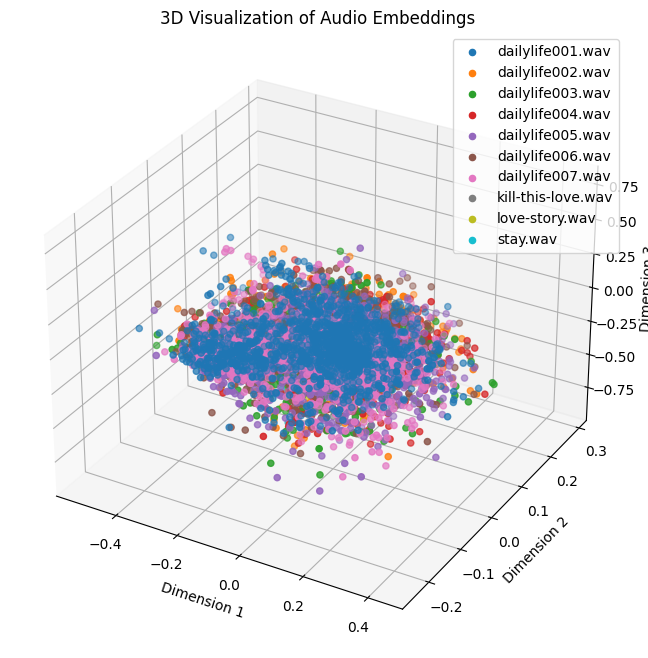

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Assuming 'embeddings_array' contains your audio embeddings
# Assuming 'labels' contains the labels (file names) for each embedding

# Extract dimensions for plotting
x = embeddings_array[:, 0]
y = embeddings_array[:, 1]
z = embeddings_array[:, 2]

# Get unique file names and assign a color to each one
unique_file_names = np.unique(labels)
num_colors = len(unique_file_names)
colors = [plt.cm.tab10(i / float(num_colors)) for i in range(num_colors)]  # Using tab10 color map

# Map each file name to a color
file_name_to_color = {file_name: color for file_name, color in zip(unique_file_names, colors)}

# Assign colors to embeddings based on file names
embedding_colors = [file_name_to_color[file_name] for file_name in labels]

# Plot embeddings in 3D space
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot embeddings with colors and labels
for file_name, color in file_name_to_color.items():
    indices = np.where(labels == file_name)[0]
    ax.scatter(x[indices], y[indices], z[indices], c=[color], label=file_name)

# Customize plot
ax.set_title('3D Visualization of Audio Embeddings')
ax.set_xlabel('Dimension 1')
ax.set_ylabel('Dimension 2')
ax.set_zlabel('Dimension 3')
ax.legend()

# Enable interactive mode
plt.ion()

plt.show()

As can be seen from the picture, most of the embedding points are tightly clustered in the central area of ​​the three-dimensional space, with only a few points scattered around this area. Such a distribution may indicate that the vast majority of audio files are very similar in speech characteristics, while those scattered points may represent distinctive audio files or outliers. However, embedding points too closely makes it impossible to discern similarities or differences between profiles in the results. Possible reasons include but are not limited to: overlapping features, information being lost during the dimension compression process, different projection methods, and different resolution capabilities of different dimensions.
Therefore, I decided to compress the results into a two-dimensional space to examine the differences between files.

In the following task, I used t-SNE (t-distributed stochastic neighbor embedding) technology to reduce the dimensionality and visualize the audio embedding vectors. t-SNE is a commonly used dimensionality reduction technique that can map high-dimensional data to two-dimensional or three-dimensional space while retaining the local structure between data points.

First, I used the t-SNE algorithm to perform dimensionality reduction on the original audio embedding vectors, mapping them from high-dimensional space to two-dimensional space. This makes it easier to visualize them on a plane and observe their distribution.

I then assigned each audio file a unique color based on its name and used these colors to mark the visualization points for each embedded vector. In this way, we can clearly see the audio file represented by each point in the two-dimensional scatter plot, and quickly identify the relationship between them based on their relative position and color.

Through this t-SNE visualization, I can more intuitively observe the distribution of speech features in two-dimensional space between different audio files, thereby gaining a deeper understanding of the similarities and differences between them.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.manifold import TSNE

In [ ]:
tsne = TSNE(n_components=2, random_state=42)
embeddings_2d = tsne.fit_transform(embeddings_array)

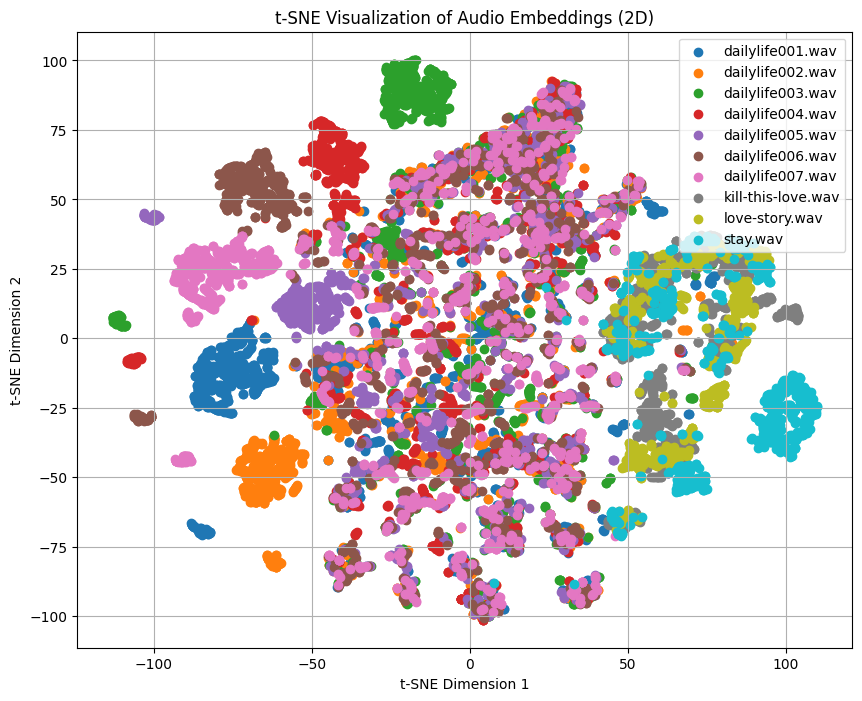

In [ ]:
x = embeddings_2d[:, 0]
y = embeddings_2d[:, 1]

# Color code based on labels
# Get unique file names and assign a color to each one
unique_file_names = np.array([file for _, file in audio_files])
num_colors = len(unique_file_names)
colors = [plt.cm.tab10(i/float(num_colors)) for i in range(num_colors)]  # Using tab10 color map

# Map each file name to a color
file_name_to_color = {file_name: color for file_name, color in zip(unique_file_names, colors)}

# Assign colors to embeddings based on file names
embedding_colors = [file_name_to_color[file_name] for file_name in labels]

# Plot embeddings in 3D space
fig = plt.figure(figsize=(10, 8))


# Plot embeddings with colors and labels
for file_name, color in file_name_to_color.items():
    indices = np.where(labels == file_name)
    plt.scatter(x[indices], y[indices], c=[color], label=file_name)

#plt.figure(figsize=(10, 8))
#plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1])
plt.title('t-SNE Visualization of Audio Embeddings (2D)')
plt.xlabel('t-SNE Dimension 1')
plt.ylabel('t-SNE Dimension 2')
plt.grid(True)
plt.legend()
plt.show()

In this result, each point represents the feature embedding of an audio file, while the colors represent different file names. We can observe that compared to the previous three-dimensional scatter plot, the data points here are more clearly grouped in the two-dimensional space, which indicates that different audio files have obvious differences in certain features.

In this t-SNE two-dimensional visualization, most of the points are concentrated near t-SNE Dimension 1 equal to 0. This phenomenon may mean that the variability in this dimension is not as large as Dimension 2, or that most audio Archives are similar in this characteristic. The place around Dimension 1 50 looks like a dividing line, which may correspond to a specific feature in high-dimensional space. This feature manifests itself differently in dialogue audio and music audio, such as rhythm, tonality, speaking speed, spectral characteristics, etc. Music files (as represented by the gray, aqua, and mustard dots) may have unique characteristics in this feature that make them stand apart from other dialogue audio spots on Dimension 1.

This distribution shows that t-SNE can better reveal the structural information between data points in two-dimensional space. This may be because the t-SNE algorithm focuses on maintaining the relative distance between data points during the dimensionality reduction process, especially points that are close to each other in high-dimensional space. Therefore, even though in the original three-dimensional space these feature embeddings appear to be overlapping and concentrated, more obvious differences can be observed in the two-dimensional space. This is because t-SNE has a certain degree of randomness when processing data and is sensitive to the local structure of the data, which allows it to better represent the relative positional relationship between data points.

# Image analysis

Now we will explore image files. First, we will read in a couple of images. Please change the working image and see how the resuts differ:

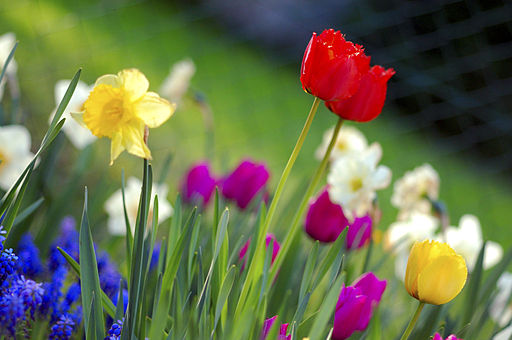

In [ ]:
image_wiki = PIL.Image.open('../data/IMAGES/Wikimedia_Conference_2016_–_Group_photo.jpg')
image_wikiGray = PIL.ImageOps.invert(image_wiki.convert('L'))

image_AllSaints = PIL.Image.open('../data/IMAGES/AllSaintsMargaretStreet-DAVID_ILIFF.jpg')
image_AllSaintsGray = PIL.ImageOps.invert(image_AllSaints.convert('L'))

image_Soyuz = PIL.Image.open('../data/IMAGES/Soyuz.jpg')
image_SoyuzGray = PIL.ImageOps.invert(image_Soyuz.convert('L'))

image_Rock = PIL.Image.open('../data/IMAGES/Bi-crystal.jpg')
image_RockGray = PIL.ImageOps.invert(image_Rock.convert('L'))

image_flowers = PIL.Image.open('../data/IMAGES/flowers.jpg')
image_flowersGray = PIL.ImageOps.invert(image_flowers.convert('L'))

image = image_flowers

image

In [ ]:
imageArr = np.asarray(image)
imageArr.shape

(340, 512, 3)

The image we have loaded is a raster image, meaning it is a grid of pixels. Each pixel contains 1-4 numbers giving the amounts of color contained in it. In this case, we can see it has 3 values per pixel, these are RGB or Red, Green and Blue values. If we want to see just the red, we can look at just that array:

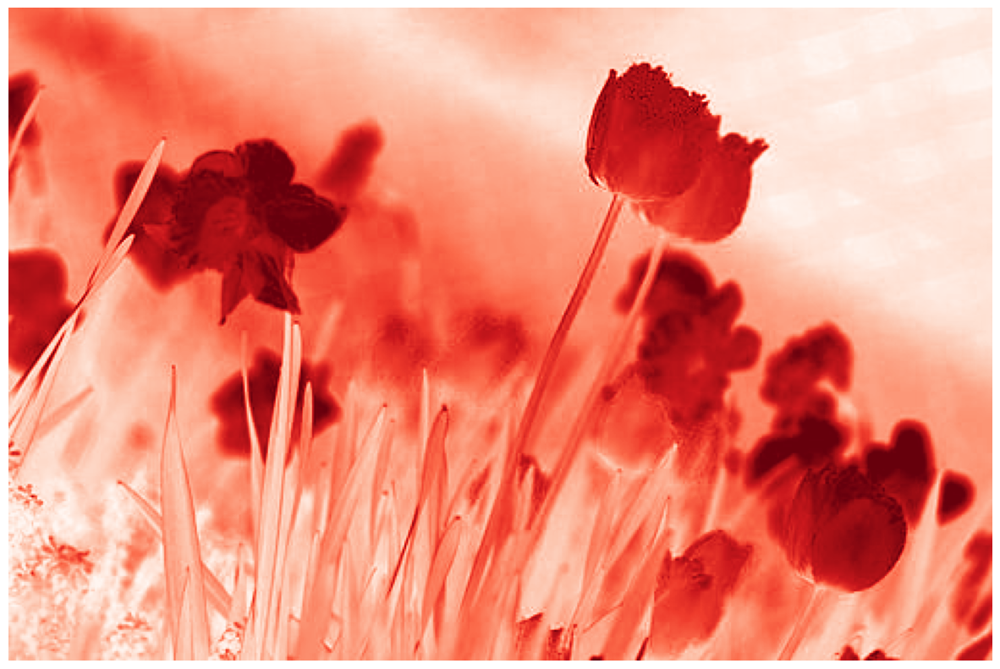

In [ ]:
imgRatio = imageArr.shape[0] / imageArr.shape[1]
fig, ax = plt.subplots(figsize = (15, 15))
ax.imshow(imageArr[:,:,0], cmap='Reds') #The order is R G B, so 0 is the Reds
ax.axis('off')
plt.show()

Or the others:

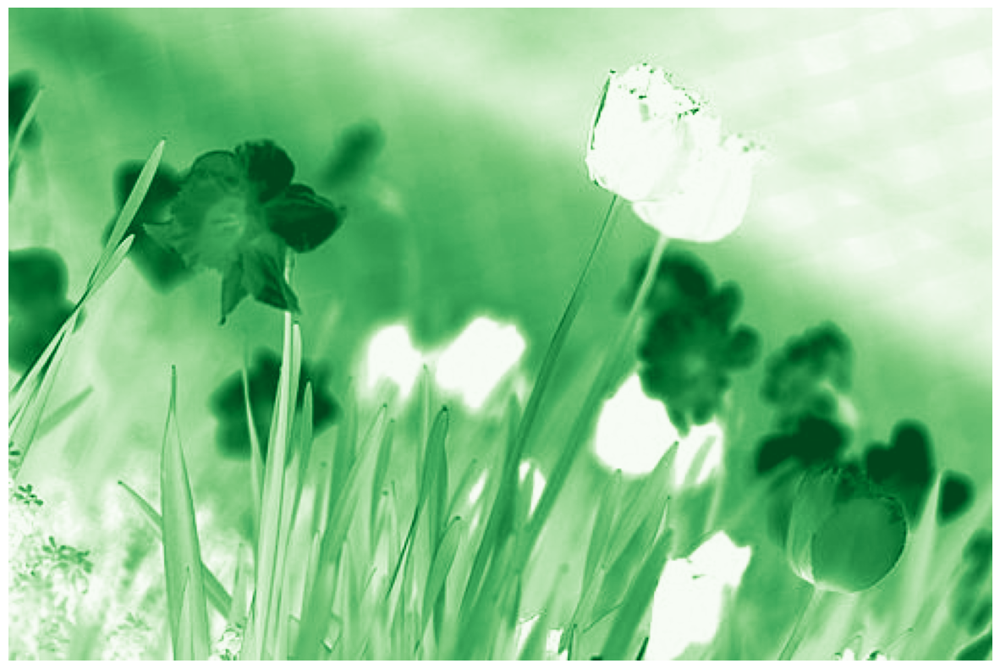

In [ ]:
imgRatio = imageArr.shape[0] / imageArr.shape[1]
fig, ax = plt.subplots(figsize = (15, 15))
ax.imshow(imageArr[:,:,1], cmap='Greens') #The order is R G B, so 2 is the Green
ax.axis('off')
plt.show()

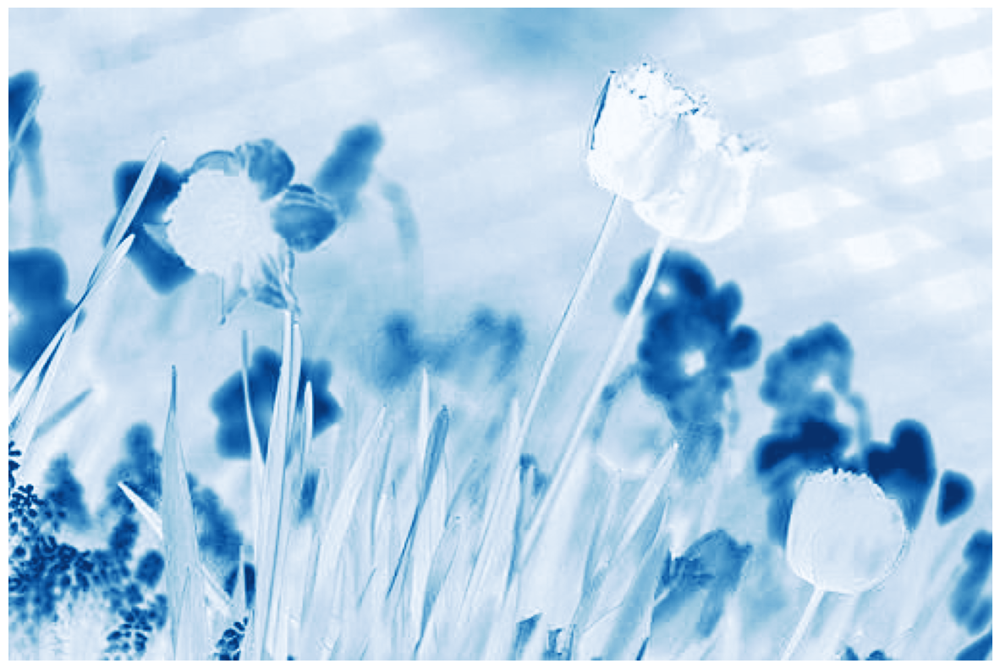

In [ ]:
imgRatio = imageArr.shape[0] / imageArr.shape[1]
fig, ax = plt.subplots(figsize = (15, 15))
ax.imshow(imageArr[:,:,2], cmap='Blues') #The order is R G B, so 2 is the Blue
ax.axis('off')
plt.show()

Or we can look at all four together:

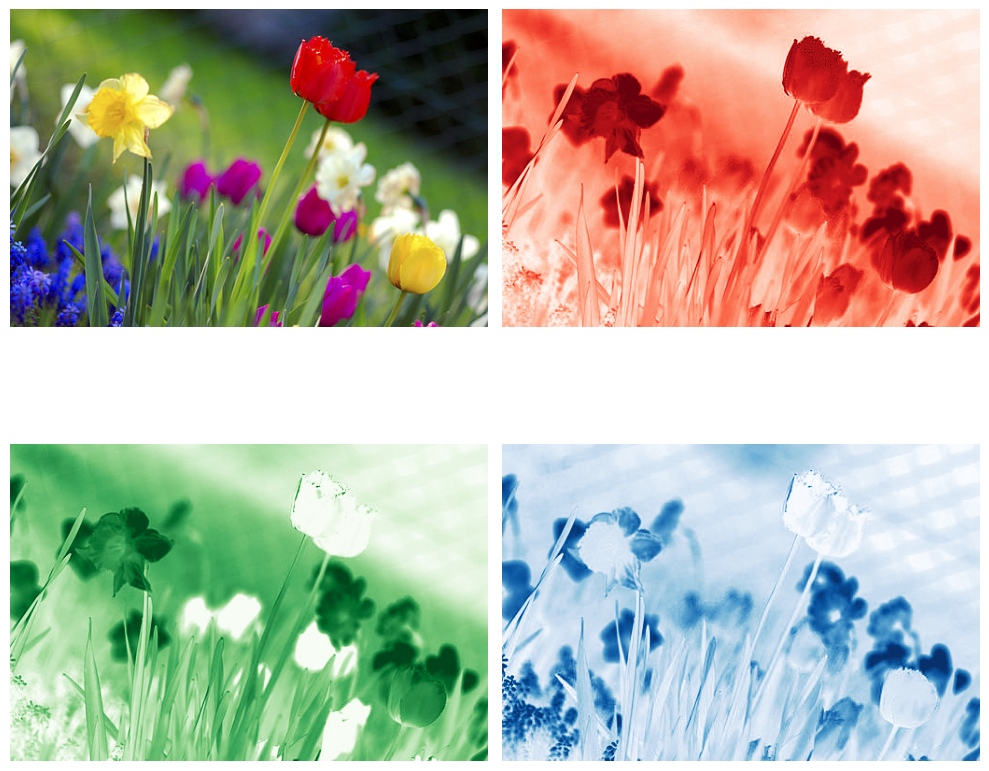

In [ ]:
fig, axes = plt.subplots(figsize = (10, 10), ncols=2, nrows=2)
axeIter = iter(axes.flatten())
colours = ["Reds", "Greens", "Blues"]
ax = next(axeIter)
ax.imshow(imageArr)
ax.axis('off')

for i in range(3):
    ax = next(axeIter)
    ax.imshow(imageArr[:,:,i], cmap=colours[i]) #The order is R G B, so 2 is the Blue
    ax.axis('off')
plt.tight_layout()
plt.show()

In [ ]:
image_gray = PIL.ImageOps.invert(image.convert('L'))
image_grayArr = np.asarray(image_gray)
image_grayArr.shape

(340, 512)

A grayscale image is defined by its pixel intensities (and a color image can be defined by its red, green, blue pixel intensities).

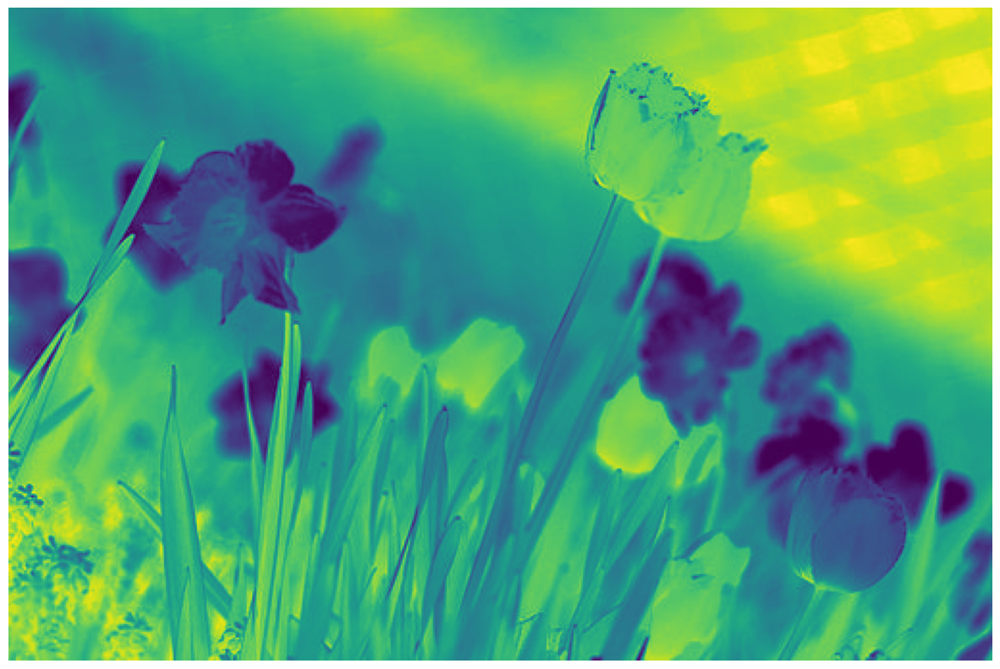

In [ ]:
imgRatio = imageArr.shape[0] / imageArr.shape[1]
fig, ax = plt.subplots(figsize = (15, 15))
ax.imshow(image_grayArr) #No third dimension
ax.axis('off')
plt.show()

# Deep Nets and Images

Modern image and video analysis is typically performed using deep learning implemented as layers of convolutional neural nets to classify scenes and to detect and label objects. We've already seen how deep learning is powerful for text (and audio, in this notebook). To learn more about deep learning and convolutional neural networks, spend some time with Andrew Ng's excellent [tutorial](http://ufldl.stanford.edu/tutorial/).

### Some Deep Learning Resources for Images
[This PyTorch tutorial](https://pytorch.org/tutorials/beginner/blitz/cifar10_tutorial.html) demonstrates how to train the classifiers. Image captioning is another application of such deep neural nets - [this GitHub repository](https://github.com/sgrvinod/a-PyTorch-Tutorial-to-Image-Captioning) walks us through how to do image captioning with pytorch. Object Detection and Scene Classification are other ways deep neural nets are used for images - [this PyTorch tutorial](https://pytorch.org/tutorials/intermediate/torchvision_tutorial.html) demonstrates Object Deteciton, and there are multiple ([1](https://github.com/buptchan/scene-classification), [2](https://github.com/ran337287/MRCNN-for-Scene-Classification), [3](https://github.com/zanilzanzan/FuseNet_PyTorch)]. Another popular open source image object detector is [UC Berkeley's caffe library](http://caffe.berkeleyvision.org) of trained and trainable neural nets written in C++. (Check out the [python api](https://github.com/BVLC/caffe/blob/master/python/caffe/pycaffe.py)). Scene classifiers can be built on top of caffe, such as MIT's [Places](http://places2.csail.mit.edu/demo.html).

# Creating Image Vectors with Deep Learning and More

While most Deep Learning methods for images are computationally heavy, there are still many ways to use the power of deep learning models (and other methods) to create useful representations of images for a variety of similarity tasks.
Most of the time intensive operations which CNNs perform happen during the training process. Model inference (which is when we use a model to either make a class prediction or embed an image in a high dimensional space), however, doesn't take so long, and we can make use of powerful pre-trained models to help us in our content analysis.

### Using Torch's pre-trained models

PyTorch is not only an elegant and powerful deep learning framework, but comes especially handy with its wide range of pre-trained models and datasets which allow for easy use. In this section, we will use AlexNet, a deep learning model famous for its performance in the 2012 ImageNet competition, where it was the best performing model (it is now cited over 70,000 times).

In [ ]:
from torchvision import models
import torch
from PIL import Image
from torchvision import transforms
import torchvision.transforms as transforms
import pandas as pd

In [ ]:
model = models.alexnet(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:01<00:00, 135MB/s]


In [ ]:
#This is code that will transform images to the appropriate format
transformations = transforms.Compose([
    transforms.Resize(255),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [ ]:
with open('../data/imagenet_classes.txt') as f:
    classes = [line.strip() for line in f.readlines()]

#organize class data so it can be mapped effectively
# classes = classes[4:len(classes)]
labels = [''.join([i for i in x if not i.isdigit()]) for x in classes]
labels = [x.replace(', ',' ') for x in labels]

In [ ]:
labels

['tench Tinca tinca',
 'goldfish Carassius auratus',
 'great white shark white shark man-eater man-eating shark Carcharodon carcharias',
 'tiger shark Galeocerdo cuvieri',
 'hammerhead hammerhead shark',
 'electric ray crampfish numbfish torpedo',
 'stingray',
 'cock',
 'hen',
 'ostrich Struthio camelus',
 'brambling Fringilla montifringilla',
 'goldfinch Carduelis carduelis',
 'house finch linnet Carpodacus mexicanus',
 'junco snowbird',
 'indigo bunting indigo finch indigo bird Passerina cyanea',
 'robin American robin Turdus migratorius',
 'bulbul',
 'jay',
 'magpie',
 'chickadee',
 'water ouzel dipper',
 'kite',
 'bald eagle American eagle Haliaeetus leucocephalus',
 'vulture',
 'great grey owl great gray owl Strix nebulosa',
 'European fire salamander Salamandra salamandra',
 'common newt Triturus vulgaris',
 'eft',
 'spotted salamander Ambystoma maculatum',
 'axolotl mud puppy Ambystoma mexicanum',
 'bullfrog Rana catesbeiana',
 'tree frog tree-frog',
 'tailed frog bell toad ribb

In [ ]:
path = "../data/IMAGES/flowers.jpg"

In [ ]:
img = Image.open(path).convert('RGB')
img_t = transformations(img)
batch_t = torch.unsqueeze(img_t, 0)
prediction = model(batch_t)

_, indices = torch.sort(prediction, descending=True)
percentage = torch.nn.functional.softmax(prediction, dim=1)[0] * 100
percentages_raw = [percentage[x].item() for x in range(0, len(percentage))]

top10 = [(labels[idx], percentage[idx].item()) for idx in indices[0][:10]]

In [ ]:
top10

[('daisy', 52.66518020629883),
 ('sulphur butterfly sulfur butterfly', 27.796463012695312),
 ('cabbage butterfly', 9.403892517089844),
 ('picket fence paling', 2.593749761581421),
 ('ladybug ladybeetle lady beetle ladybird ladybird beetle',
  1.2089834213256836),
 ('snail', 1.0514533519744873),
 ('bee', 0.7807398438453674),
 ('matchstick', 0.6509411931037903),
 ('mantis mantid', 0.48330122232437134),
 ('cardoon', 0.4350958466529846)]

We see here that we can use this pre-trained model to gather some useful information - the top 10 labels predicted by the model, as well as the probability of it belonging to that class. It does a pretty good job too, with the flower.

Let's now use a more recent model to create an embeddings: resnet.

In [ ]:
# Load the pretrained model
model = models.resnet18(pretrained=True)

# Use the model object to select the desired layer
layer = model._modules.get('avgpool')

# Set model to evaluation mode
d = model.eval()

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 136MB/s]


In [ ]:
def get_vector(image):
    # code adapted from the package:
    # https://github.com/christiansafka/img2vec/
    # Create a PyTorch tensor with the transformed image
    t_img = transformations(image)
    # Create a vector of zeros that will hold our feature vector
    # The 'avgpool' layer has an output size of 512
    my_embedding = torch.zeros(512)

    # Define a function that will copy the output of a layer
    def copy_data(m, i, o):
        my_embedding.copy_(o.flatten())                 # <-- flatten

    # Attach that function to our selected layer
    h = layer.register_forward_hook(copy_data)
    # Run the model on our transformed image
    with torch.no_grad():                               # <-- no_grad context
        model(t_img.unsqueeze(0))                       # <-- unsqueeze
    # Detach our copy function from the layer
    h.remove()
    # Return the feature vector
    return my_embedding

In [ ]:
from PIL import Image

In [ ]:
image = Image.open(path).convert('RGB')

In [ ]:
get_vector(image)

tensor([1.4099e+00, 1.8874e-01, 1.0041e+00, 4.0757e+00, 6.9075e-01, 1.6152e-01,
        4.0222e-01, 8.7628e-01, 4.8915e-01, 6.1854e-01, 4.9553e-01, 8.6477e-01,
        5.4757e-01, 8.0908e-01, 3.5628e-01, 7.5018e-02, 6.6615e-01, 1.9419e+00,
        2.0998e+00, 1.1396e+00, 6.7138e-01, 1.5799e+00, 5.4551e-01, 3.7386e-01,
        3.0412e-01, 1.1408e-01, 3.9233e-01, 3.0956e-01, 7.8363e-01, 9.9088e-01,
        1.9471e-01, 2.0220e+00, 6.7669e-01, 1.0111e-01, 5.4501e-01, 7.5322e-02,
        2.3581e+00, 3.4929e-01, 2.6464e+00, 1.0570e+00, 2.3270e-01, 2.8325e-01,
        8.6317e-01, 5.0438e-02, 1.2009e+00, 5.6483e-01, 1.0668e+00, 7.2879e-01,
        7.1061e-01, 5.1529e-01, 6.8452e-02, 1.6261e+00, 4.5136e-01, 7.4363e-02,
        1.1791e+00, 2.3383e-01, 5.5380e-01, 1.1346e+00, 3.3675e-01, 3.1364e-01,
        1.0452e+00, 7.0081e-01, 1.0980e-01, 5.7670e-02, 1.9820e-01, 9.1984e-01,
        3.4298e-02, 1.0029e+00, 1.1869e+00, 0.0000e+00, 8.4842e-01, 1.9505e-01,
        1.1815e+00, 0.0000e+00, 2.2712e-

Neat! So we just passed our transformed coffee image to the pre-trained resnet model and got a 512 dimensional image vector as the result. resent uses this vector to classify it. We can expect this image embedding to contain information of what are the coffee like characteristics of an image.

The same code is wrapped up in the package img2vec_pytorch, and so far features a quick vector creation pipeline for resnet and AlexNet.

In [ ]:
!pip install -q img2vec_pytorch

In [ ]:
from img2vec_pytorch import Img2Vec # pip install img2vec_pytorch

In [ ]:
img2vec = Img2Vec()

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
flower_vec = img2vec.get_vec(image)

In [ ]:
flower_vec

array([1.02734327e+00, 1.75804645e-02, 1.34778190e+00, 4.48179388e+00,
       5.46130419e-01, 2.20187437e-02, 5.83084464e-01, 1.21687305e+00,
       1.43548739e+00, 8.88907135e-01, 5.61262727e-01, 2.17193708e-01,
       7.56725490e-01, 1.03098798e+00, 1.58463910e-01, 3.77263755e-01,
       5.72253704e-01, 1.64269102e+00, 1.53232813e+00, 7.75364757e-01,
       5.13926983e-01, 9.85879958e-01, 3.93517971e-01, 7.04159856e-01,
       2.02142954e-01, 9.49164033e-02, 2.16963708e-01, 4.74577844e-01,
       6.51601195e-01, 1.01688552e+00, 4.49991077e-01, 2.18734837e+00,
       1.05579817e+00, 6.42501235e-01, 4.14260507e-01, 5.80828667e-01,
       1.71087992e+00, 1.99840933e-01, 1.63960719e+00, 1.64381802e+00,
       2.87263006e-01, 4.09101784e-01, 1.50390184e+00, 2.60305274e-02,
       1.48959637e+00, 7.76725948e-01, 6.45726442e-01, 4.69465971e-01,
       5.55227458e-01, 5.39888442e-01, 1.58643067e-01, 1.74502242e+00,
       1.45893896e+00, 1.04713462e-01, 8.91955316e-01, 5.60247749e-02,
      

In [ ]:
cat_image = Image.open("../data/IMAGES/cat.png")

In [ ]:
dog_image = Image.open("../data/IMAGES/dog.png")

These vectors are useful because we can then do basic similarity checks using them.

In [ ]:
cat_vec = img2vec.get_vec(cat_image.convert('RGB'), tensor=True)

In [ ]:
dog_vec = img2vec.get_vec(dog_image.convert('RGB'), tensor=True)

In [ ]:
flower_vec = img2vec.get_vec(image, tensor=True)

In [ ]:
cos = nn.CosineSimilarity(dim=1, eps=1e-6)

In [ ]:
cos_sim = cos(cat_vec,
              dog_vec)


In [ ]:
cos_sim

tensor([[[0.6376]]])

In [ ]:
cos_sim = cos(flower_vec,
              dog_vec)

In [ ]:
cos_sim

tensor([[[0.5406]]])

This makes sense - the dog and cat are more similar than the dog and flower. We now have a way to compare between images outside of the RGB distribution.

This notebook is only a very brief introduction to audio and visual deep learning. This is a very important and exciting area of research, especially for social scientists who can make use of state-of-the-art Python tools. More tutorials like this are available in the [Thinking with Deep Learning course notebooks](https://github.com/UChicago-Thinking-Deep-Learning-Course/Tutorials-Homework-Notebooks/tree/main/week-6).

## <font color="red">*Exercise 3*</font>

<font color="red">You can either:
    
<font color="red">a) Construct cells immediately below this that report the results from experiments in which you place each of images taken or retrieved for the last exercise through the online demos for [caffe](http://demo.caffe.berkeleyvision.org) and [places](http://places.csail.mit.edu/demo.html). Paste the image and the output for both object detector and scene classifier below, beside one another. Calculate precision and recall for caffe's ability to detect objects of interest across your images. What do you think about Places' scene categories and their assignments to your images?
    
<font color="red">b) Implement any one deep learning example using PyTorch and images. What does the pre-trained model see in your images?
    
<font color="red">c) Use some form of vectorisation of images - (a deep learning one, or an RGB representation, or HSV) and use simlarity measures or clustering to explore your image data.

<font color="red">Could you use image classification to enhance your research project and, if so, how? How would multi-modal data sources make your analysis more powerful?

In [ ]:
import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
import os
import pandas as pd
from torchvision.models import resnet18
from torchvision.transforms import ToTensor

In [ ]:
# Hyperparameters
num_epochs = 5
batch_size = 64
learning_rate = 0.005

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = resnet18(pretrained=True)
model.conv1 = nn.Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
model = model.to(device)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=0.9, weight_decay=5e-4)

In [ ]:
train_dataset = torchvision.datasets.MNIST(root= './data', train = True, download = True, transform = ToTensor())
test_dataset = torchvision.datasets.MNIST(root= './data', train = False, download = True, transform = ToTensor())
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size = batch_size, shuffle = True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size = batch_size, shuffle = True)

total_steps = len(train_loader)
print(f'Total steps: {total_steps}')

100%|██████████| 9912422/9912422 [00:00<00:00, 107106138.87it/s]


Extracting ./data/MNIST/raw/train-images-idx3-ubyte.gz to ./data/MNIST/raw



100%|██████████| 28881/28881 [00:00<00:00, 11251689.93it/s]


Extracting ./data/MNIST/raw/train-labels-idx1-ubyte.gz to ./data/MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 44744805.66it/s]


Extracting ./data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./data/MNIST/raw



100%|██████████| 4542/4542 [00:00<00:00, 5427501.07it/s]

Extracting ./data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/MNIST/raw

Total steps: 1500


In [ ]:
for epoch in range(num_epochs):
   for i, (imgs , labels) in enumerate(train_loader):
     imgs = imgs.to(device)
     labels = labels.to(device)
     optimizer.zero_grad()

     # Forward
     labels_pred = model(imgs)
     num_correct = (labels_pred.argmax(axis=1) == labels).sum().item()
     loss = criterion(labels_pred, labels)

     # Backward
     loss.backward()
     optimizer.step()

     if (i+1) % 100 == 0:
        print(f'epoch {epoch+1}/{num_epochs}, step: {i+1}/{total_steps}, loss = {loss:.5f}, training accuracy = {100*(num_correct/labels.size(0)):.2f}%')
   print(f'epoch {epoch} completed. loss = {loss:.5f}, training accuracy = {100*(num_correct/labels.size(0)):.2f}%')

epoch 1/5, step: 100/1500, loss = 0.00134, training accuracy = 100.00%
epoch 1/5, step: 200/1500, loss = 0.03289, training accuracy = 97.50%
epoch 1/5, step: 300/1500, loss = 0.00968, training accuracy = 100.00%
epoch 1/5, step: 400/1500, loss = 0.00989, training accuracy = 100.00%
epoch 1/5, step: 500/1500, loss = 0.12391, training accuracy = 97.50%
epoch 1/5, step: 600/1500, loss = 0.00547, training accuracy = 100.00%
epoch 1/5, step: 700/1500, loss = 0.01442, training accuracy = 100.00%
epoch 1/5, step: 800/1500, loss = 0.00245, training accuracy = 100.00%
epoch 1/5, step: 900/1500, loss = 0.05066, training accuracy = 97.50%
epoch 1/5, step: 1000/1500, loss = 0.06656, training accuracy = 95.00%
epoch 1/5, step: 1100/1500, loss = 0.04977, training accuracy = 97.50%
epoch 1/5, step: 1200/1500, loss = 0.01584, training accuracy = 100.00%
epoch 1/5, step: 1300/1500, loss = 0.20294, training accuracy = 95.00%
epoch 1/5, step: 1400/1500, loss = 0.07523, training accuracy = 97.50%
epoch 1/

In [ ]:
model.eval()
correct = 0
total = 0
with torch.no_grad():
    for data in test_loader:
        images, labels = data
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

print(f'Test Accuracy on {len(test_dataset)} test images: {100 * correct / total}')

Test Accuracy on 10000 test images: 99.28


In this task, I used a pretrained ResNet-18 model and fine-tuned it to classify handwritten digits on the MNIST dataset. I divided the data set into a training set and a test set, and used the DataLoader provided by PyTorch to load the data. During the training process, I used the cross-entropy loss function as the loss function of the model and adopted stochastic gradient descent (SGD) as the optimizer to update the parameters of the model. Through iterative training, I observed the model's accuracy gradually improve on the training set, eventually reaching an astonishing 99.28% accuracy on the test set. This means that the model can classify handwritten digits with high accuracy, demonstrating its excellent performance in image classification tasks.

# Optional: Do androids dream of electric sheep?
If text and images can both be turned into vectors, why not transform one into the other? We can turn images to text with classification (e.g., ImageNet) or captioning, and we can turn text to images. If you're using the the ChatGPT with the web interface, you've probably had a try on prompting ChatGPT to generate images(If not, try it now!) via it's image engine DALL·E.

Rome was not built in one day. OpenAI's DALL·E was based on their previous transformer-based model [CLIP](https://openai.com/blog/clip/).
Here are a few images generated with [Deep Daze](https://github.com/lucidrains/deep-daze), which uses CLIP. You can see how the technology evolves.

<img src="https://github.com/lucidrains/deep-daze/raw/main/samples/Mist_over_green_hills.jpg" width="256px"></img>

<center>*mist over green hills*</center>

<img src="https://github.com/lucidrains/deep-daze/raw/main/samples/Life_during_the_plague.jpg" width="256px"></img>

<center>*life during the plague*</center>

<img src="https://github.com/lucidrains/deep-daze/raw/main/samples/A_man_painting_a_completely_red_image.png" width="256px"></img>

<center>*a man painting a completely red image*</center>

With a decent GPU, you can make these images yourself! Wouldn't this make a cool title slide for your final project presentation?

The Deep Daze model can be ran by installing a `pip` package and running on the command prompt.

```
!pip install deep-daze
!imagine "a robotic aristocrat, in the style of Rembrandt"
```

Another branch of techonogly that DALL·E relies on is diffusion models, which process starts with noise and gradually refines it into a coherent image that matches the description provided. Here, I recommend instead using one of the Colab notebooks with diffusion models, which are newer, faster, and produce (in my opinion) cooler output. A great one is [Disco Diffusion](https://colab.research.google.com/github/alembics/disco-diffusion/blob/main/Disco_Diffusion.ipynb), based on [Guided Diffusion](https://github.com/openai/guided-diffusion) made by... big surprise.... OpenAI! To use that notebook (as of March 2022):

1. Click `Copy to Drive` and switch to your new copy.
2. Scroll down and change the `text_prompt[0]` from "A beautiful painting..." to something related to your final project.
3. Click `Runtime -> Change runtime type` and select `GPU`. Note that Colab Pro might give you a better GPU.
4. Click `Runtime -> Run all`.

The rest of the notebook are just a huge range of settings you can play with for desired output. You can decrease or increase the number of iterations or epochs for faster test runs or a high-quality final product. Keep in mind that creating a video rather than images requires a lot more computation.

There is another similar notebook [v-diffusion-pytorch](https://colab.research.google.com/drive/1M4QKDt5ExIo3GLml0YKcJM9gfaX9ptfg) that you can experiment with. (From my experimentation, V Diffusion seems to be the fastest, and ithe quality is better than Deep Daze but not as good as Disco Diffusion.)

Remember that many AI tools start out looking like parlor tricks before we're able to scale them up and find practical applications, and this field is progressing at a breakneck rate. We're only at [the beginning of the future](https://80000hours.org/articles/future-generations/)! (Ofc OpenAI has released the amazing Sora video generation model, which seems to be the begining) The model has not been officially released yet, you're also encouraged to read the [technical report](https://openai.com/sora) or @ Sam Altman on X to let him generate some Sora videos for you :)


## <font color="red">*Stretch (not required)*</font>

<font color="red">Take a look at those models and try to generate images using differnet models (DALL·E, CLIP, Diffusion models, etc.) and show how the models made progress on image generation (e.g., how to acurately generate fingers)